In [2]:
import pandas as pd
import numpy as np
import os
from data_revised_prep import *

import sys
import cv2

import shutil
import pydicom

from icecream import ic

import pydicom
import matplotlib.pyplot as plt

# Steps to organize the ADNI dataset: 

1) Open a folder named "data-ADNI3-revised", 

2) inside "data-ADNI-revised" folder, add a subfolder named "raw" , also subfolder named "interim". 

3) As a subfolder of raw, create "ADNI3". As a subfolder of interim, create "ADNI3".

3) into the "raw" folder, add the unzipped data folders which are named as "3_ASMP_Sagittal_AD", "3_ASMP_Sagittal_CN","3_ASMP_Sagittal_MCI".

In [3]:
df_AD = pd.read_csv("../revised_dataset/3_ASMP_Sagittal_AD_4_01_2024.csv")
new_df_AD= remove_duplicates(df_AD)

data_folder_AD = "/Users/cisilkaraguzel/Documents/GitHub/AD_detection_DL_approach/data-ADNI3-revised/raw/ADNI3/3_ASMP_Sagittal_AD"  
data_paths_AD = get_filtrated_data_paths(data_folder_AD, new_df_AD["Image Data ID"].tolist())

print('The number of AD subjects is '+str(len(new_df_AD)))
print('The number of total AD image paths is '+str(len(data_paths_AD)))

The number of AD subjects is 52
The number of total AD image paths is 10320


In [4]:
df_CN = pd.read_csv("../revised_dataset/3_ASMP_Sagittal_CN_4_01_2024.csv")
new_df_CN= remove_duplicates(df_CN)

data_folder_CN = "/Users/cisilkaraguzel/Documents/GitHub/AD_detection_DL_approach/data-ADNI3-revised/raw/ADNI3/3_ASMP_Sagittal_CN"  
data_paths_CN = get_filtrated_data_paths(data_folder_CN, new_df_CN["Image Data ID"].tolist())

print('The number of CN subjects is '+str(len(new_df_CN)))
print('The number of total image CN paths is '+str(len(data_paths_CN)))

The number of CN subjects is 381
The number of total image CN paths is 11363


In [5]:
df_MCI = pd.read_csv("../revised_dataset/3_ASMP_Sagittal_MCI_4_01_2024.csv")
new_df_MCI= remove_duplicates(df_MCI)

data_folder_MCI = "/Users/cisilkaraguzel/Documents/GitHub/AD_detection_DL_approach/data-ADNI3-revised/raw/ADNI3/3_ASMP_Sagittal_MCI"  
data_paths_MCI = get_filtrated_data_paths(data_folder_MCI, new_df_MCI["Image Data ID"].tolist())

print('The number of MCI subjects is '+str(len(new_df_MCI)))
print('The number of total image MCI paths is '+str(len(data_paths_MCI)))

The number of MCI subjects is 184
The number of total image MCI paths is 36064


# Example

In [6]:
data_paths_CN_example = get_filtrated_data_paths(data_folder_CN, ["I1571742"])

# Sort the list of paths based on instance numbers
sorted_dicom_paths = sorted(data_paths_CN_example, key=lambda path: get_instance_number(path))

# Example usage
#for dicom_path in sorted_dicom_paths:
    #print(dicom_path)

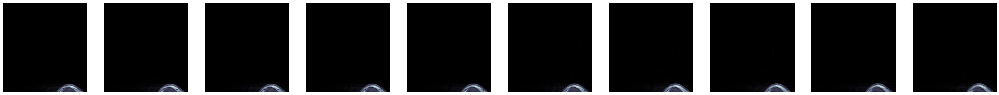

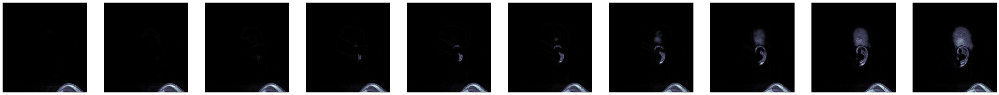

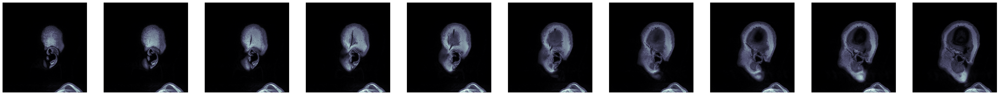

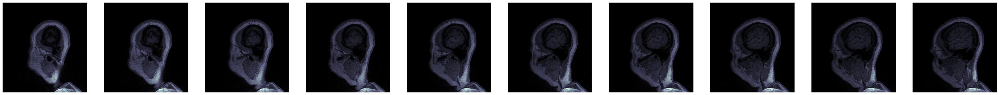

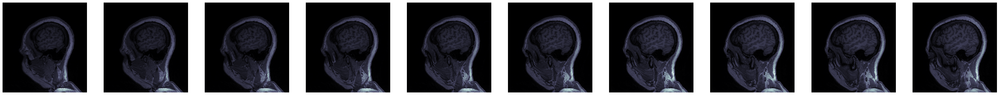

...

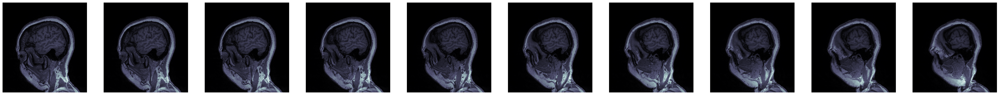

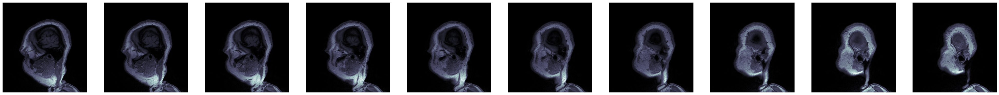

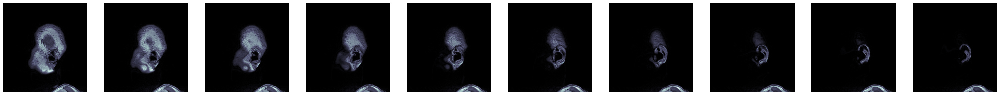

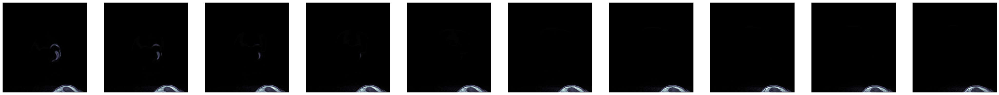

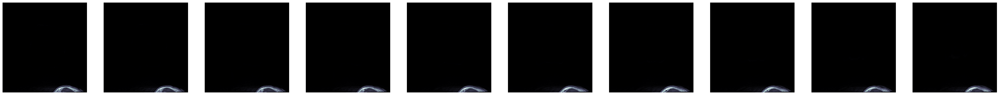

In [13]:
a=10
for j in range(1,20):
    plot_new_dicom_images(sorted_dicom_paths, num_images=10, i=a)
    a += 10

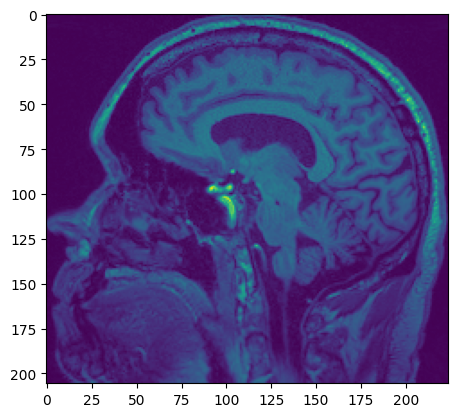

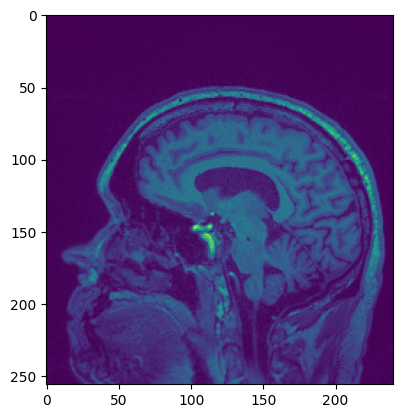

In [8]:
path= "/Users/cisilkaraguzel/Documents/GitHub/AD_detection_DL_approach/data-ADNI3-revised/raw/ADNI3/3_ASMP_Sagittal_AD/ADNI/033_S_6976/Accelerated_Sagittal_MPRAGE/2023-07-21_10_21_39.0/I10245972/ADNI_033_S_6976_MR_Accelerated_Sagittal_MPRAGE__br_raw_20230721135727561_98.dcm"

crop_black_frame(path)

plt.imshow(crop_black_frame(path))
plt.show()

plt.imshow(pydicom.dcmread(path).pixel_array)
plt.show()

In [9]:
dcm_data = pydicom.dcmread(path)
len(dcm_data.pixel_array)

256